In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Import Data

In [2]:
brain_data = pd.read_csv('./data/eig_centrality.csv', header=None)
brain_data.head()

,0,1,2,3,4,5,6,7,8,9,...,285,286,287,288,289,290,291,292,293,294
0,1,-0.067894,-0.062832,0,0,0,-0.031240,-0.071004,0,0,...,-0.112760,-0.106070,0.000000e+00,0.000000e+00,-0.028195,-0.024616,-0.042535,-0.087451,0.003145,-0.047196
1,1,0.031793,0.025996,0,0,0,0.122030,0.109220,0,0,...,0.078364,0.049836,0.000000e+00,6.938900e-18,-0.076947,-0.078418,-0.064815,0.095082,0.054585,0.076347
2,1,-0.005251,-0.015806,0,0,0,-0.124040,-0.117020,0,0,...,0.021125,0.014470,0.000000e+00,-1.734700e-18,0.068705,0.084321,0.047107,0.004649,-0.142760,-0.129450
3,1,0.123150,0.096576,0,0,0,-0.045236,-0.005143,0,0,...,-0.043127,-0.024063,5.551100e-17,-1.110200e-16,-0.064510,-0.100380,-0.112950,-0.099919,-0.006036,-0.004228
4,1,-0.059846,-0.024500,0,0,0,-0.022105,0.022153,0,0,...,-0.026404,-0.004397,-4.336800e-19,0.000000e+00,-0.068379,0.006091,-0.050172,0.056009,0.077894,0.016500


# Means

In [3]:
# Data statistics
brain_data.describe()

,0,1,2,3,4,5,6,7,8,9,...,285,286,287,288,289,290,291,292,293,294
count,60.000000,60.000000,60.000000,60.0,60.0,60.0,60.000000,60.000000,60.0,60.0,...,60.000000,60.000000,6.000000e+01,6.000000e+01,60.000000,60.000000,60.000000,60.000000,60.000000,60.000000
mean,0.516667,-0.001560,0.000037,0.0,0.0,0.0,-0.013432,-0.009640,0.0,0.0,...,-0.008441,-0.004802,7.846891e-19,-3.420597e-18,-0.005593,-0.005852,-0.011398,-0.004166,-0.004192,-0.008979
std,0.503939,0.067542,0.060630,0.0,0.0,0.0,0.069750,0.059272,0.0,0.0,...,0.057398,0.057215,7.355967e-18,2.186143e-17,0.058103,0.059368,0.057538,0.049855,0.063680,0.059190
min,0.000000,-0.133750,-0.113810,0.0,0.0,0.0,-0.147870,-0.117020,0.0,0.0,...,-0.112760,-0.106070,-6.938900e-18,-1.110200e-16,-0.107040,-0.111130,-0.120680,-0.099919,-0.142760,-0.129450
25%,0.000000,-0.054123,-0.041246,0.0,0.0,0.0,-0.064167,-0.055781,0.0,0.0,...,-0.055681,-0.055540,0.000000e+00,0.000000e+00,-0.051383,-0.051799,-0.051540,-0.040321,-0.046702,-0.051699
50%,1.000000,-0.003182,-0.002971,0.0,0.0,0.0,-0.026964,-0.010316,0.0,0.0,...,-0.014444,-0.004769,0.000000e+00,0.000000e+00,0.006788,-0.002191,-0.009056,-0.001860,-0.005560,-0.011563
75%,1.000000,0.040974,0.042879,0.0,0.0,0.0,0.041256,0.030718,0.0,0.0,...,0.045364,0.050819,0.000000e+00,0.000000e+00,0.041511,0.040635,0.028911,0.031589,0.043188,0.036146
max,1.000000,0.147730,0.147670,0.0,0.0,0.0,0.122030,0.119670,0.0,0.0,...,0.107930,0.092007,5.551100e-17,5.551100e-17,0.111630,0.111860,0.101670,0.102510,0.121260,0.105320


<AxesSubplot:title={'center':'All'}, xlabel='Feature', ylabel='mean of features'>

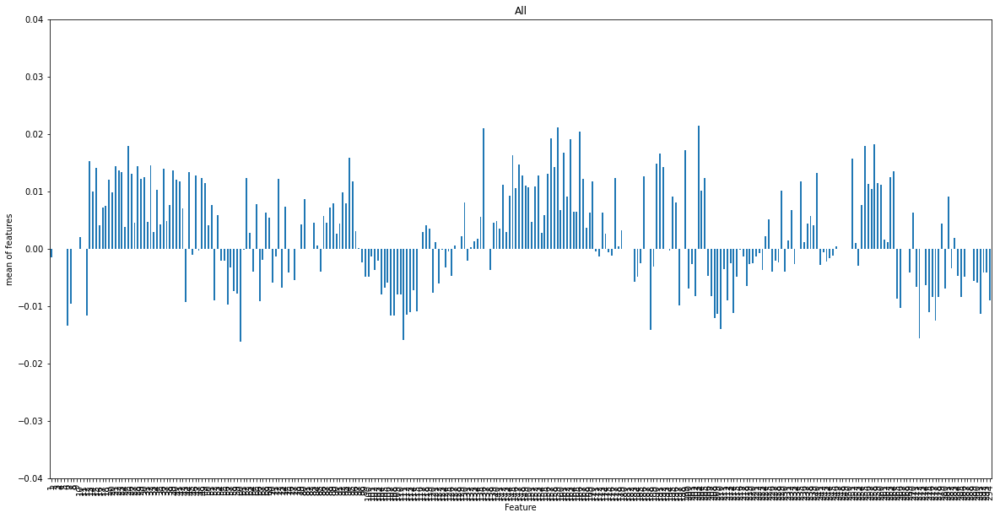

In [4]:
# plot means of all feature for all patients
brain_data.iloc[:,1:].mean().plot(kind='bar', figsize=(20,10), ylabel='mean of features', xlabel='Feature', ylim=(-0.04,0.04), title='All')

## Plot means for patients without alz


In [5]:
brain_data_control = brain_data[brain_data[0] == 0]
brain_data_control.head()

,0,1,2,3,4,5,6,7,8,9,...,285,286,287,288,289,290,291,292,293,294
31,0,-0.073850,-0.067370,0,0,0,-0.039203,0.007984,0,0,...,-0.083530,-0.088748,0.000000e+00,0.000000e+00,0.009333,-0.003645,-0.004680,-0.005652,-0.058902,-0.021986
32,0,-0.007477,0.030839,0,0,0,-0.027184,-0.006316,0,0,...,0.041812,0.075199,0.000000e+00,-1.734700e-18,-0.107040,-0.111130,-0.059544,0.040218,0.007276,-0.017958
33,0,0.018437,0.061860,0,0,0,-0.103210,-0.077021,0,0,...,-0.054337,-0.054819,-1.734700e-18,-6.938900e-18,0.032942,0.059597,-0.017278,-0.093595,-0.003241,-0.035667
34,0,-0.036331,-0.046393,0,0,0,0.104860,0.050941,0,0,...,0.107930,0.092007,-5.421000e-20,0.000000e+00,0.048051,0.006444,0.088322,0.010914,0.099691,0.095473
35,0,0.076509,0.060253,0,0,0,-0.004090,0.025761,0,0,...,-0.063173,-0.041957,0.000000e+00,0.000000e+00,-0.098832,-0.085524,-0.117420,-0.064931,0.014703,-0.000845


<AxesSubplot:title={'center':'Control'}, xlabel='Feature', ylabel='mean of features'>

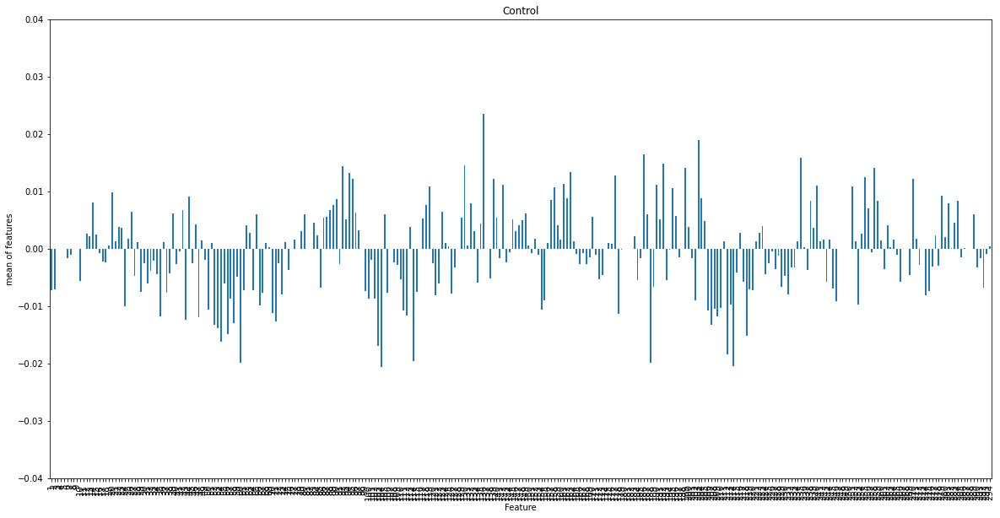

In [6]:
brain_data_control.iloc[:,1:].mean().plot(kind='bar', figsize=(20,10), ylabel='mean of features', xlabel='Feature', ylim=(-0.04,0.04), title='Control')

## Plot means for patients with alz

In [7]:
brain_data_alz = brain_data[brain_data[0] == 1]
brain_data_alz.head()

,0,1,2,3,4,5,6,7,8,9,...,285,286,287,288,289,290,291,292,293,294
0,1,-0.067894,-0.062832,0,0,0,-0.031240,-0.071004,0,0,...,-0.112760,-0.106070,0.000000e+00,0.000000e+00,-0.028195,-0.024616,-0.042535,-0.087451,0.003145,-0.047196
1,1,0.031793,0.025996,0,0,0,0.122030,0.109220,0,0,...,0.078364,0.049836,0.000000e+00,6.938900e-18,-0.076947,-0.078418,-0.064815,0.095082,0.054585,0.076347
2,1,-0.005251,-0.015806,0,0,0,-0.124040,-0.117020,0,0,...,0.021125,0.014470,0.000000e+00,-1.734700e-18,0.068705,0.084321,0.047107,0.004649,-0.142760,-0.129450
3,1,0.123150,0.096576,0,0,0,-0.045236,-0.005143,0,0,...,-0.043127,-0.024063,5.551100e-17,-1.110200e-16,-0.064510,-0.100380,-0.112950,-0.099919,-0.006036,-0.004228
4,1,-0.059846,-0.024500,0,0,0,-0.022105,0.022153,0,0,...,-0.026404,-0.004397,-4.336800e-19,0.000000e+00,-0.068379,0.006091,-0.050172,0.056009,0.077894,0.016500


# All Feature means and medians plots

<AxesSubplot:title={'center':'Control: median'}, xlabel='Feature', ylabel='median of features'>

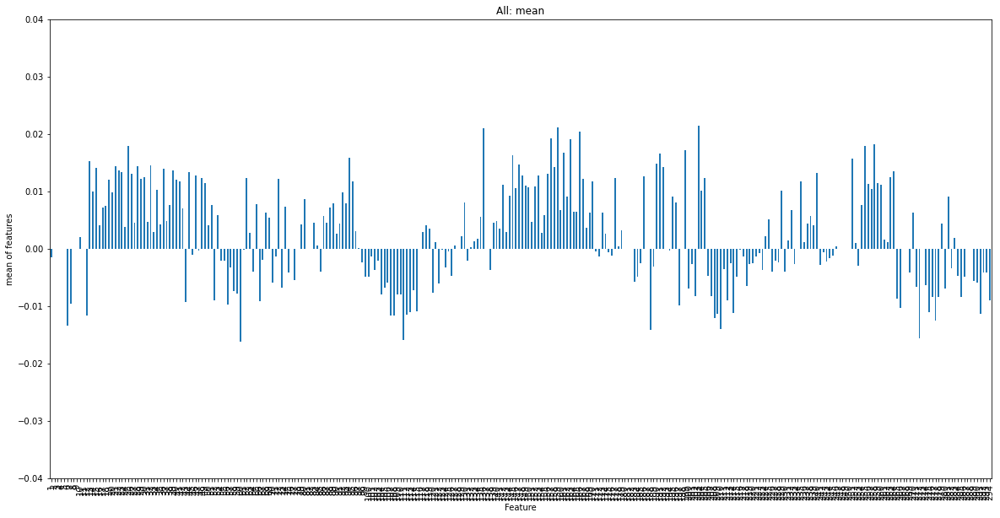

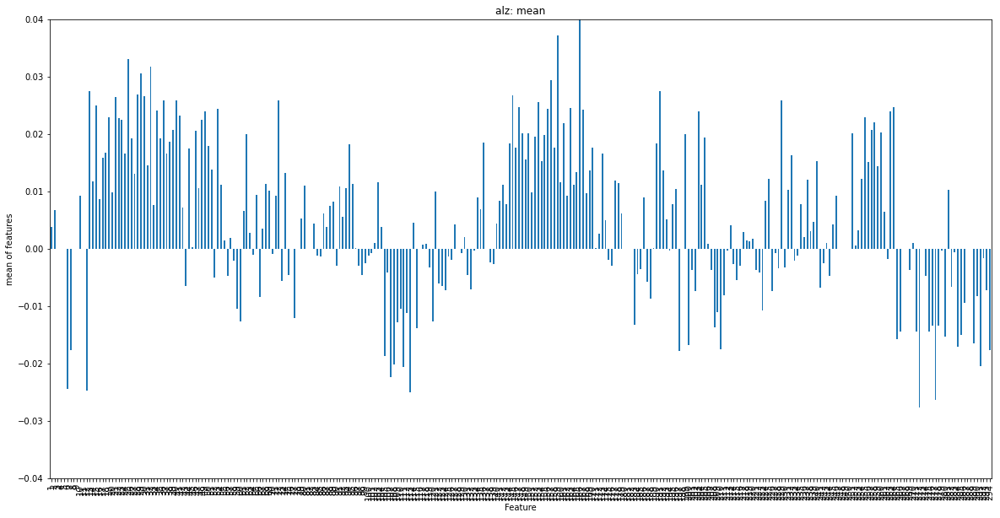

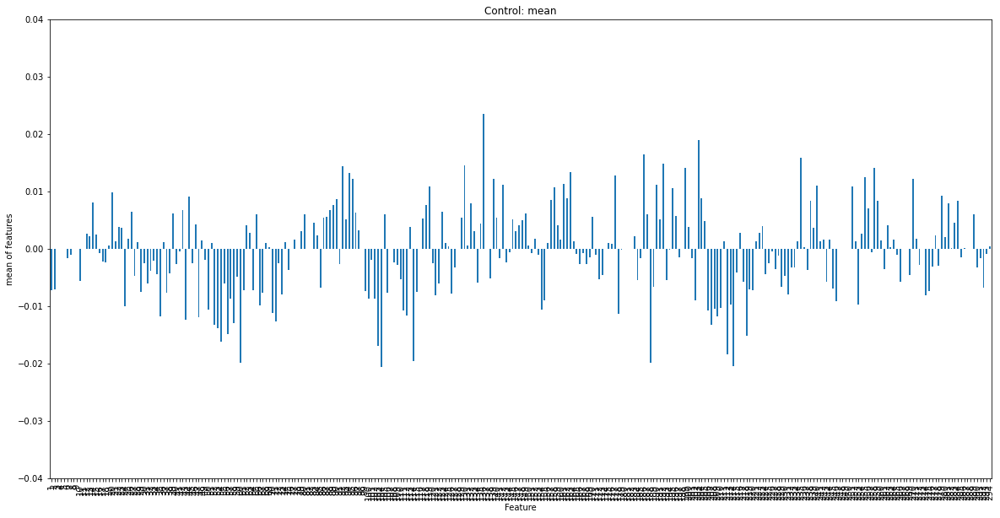

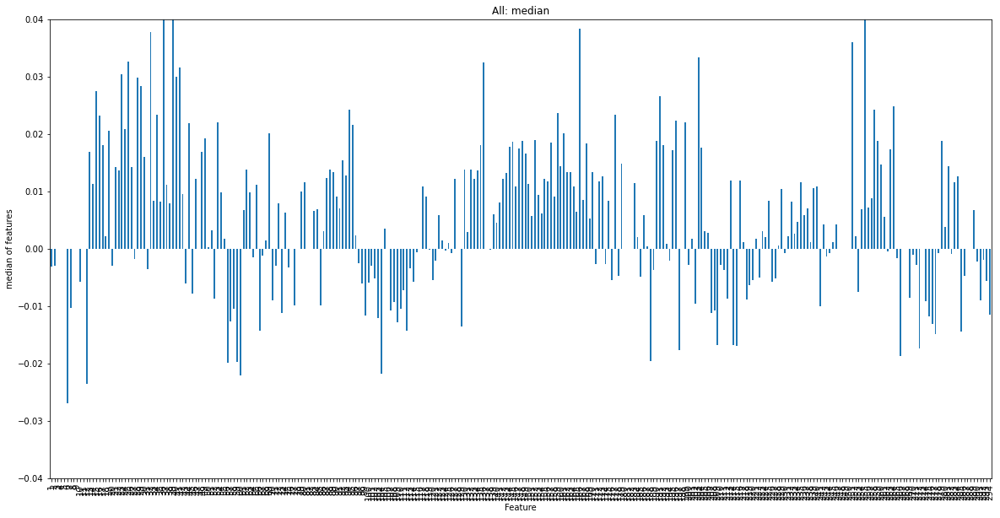

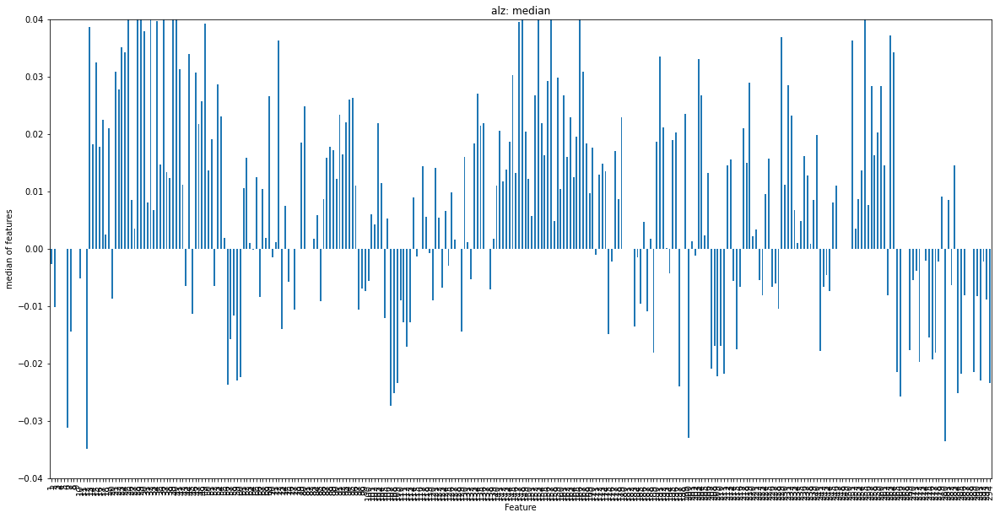

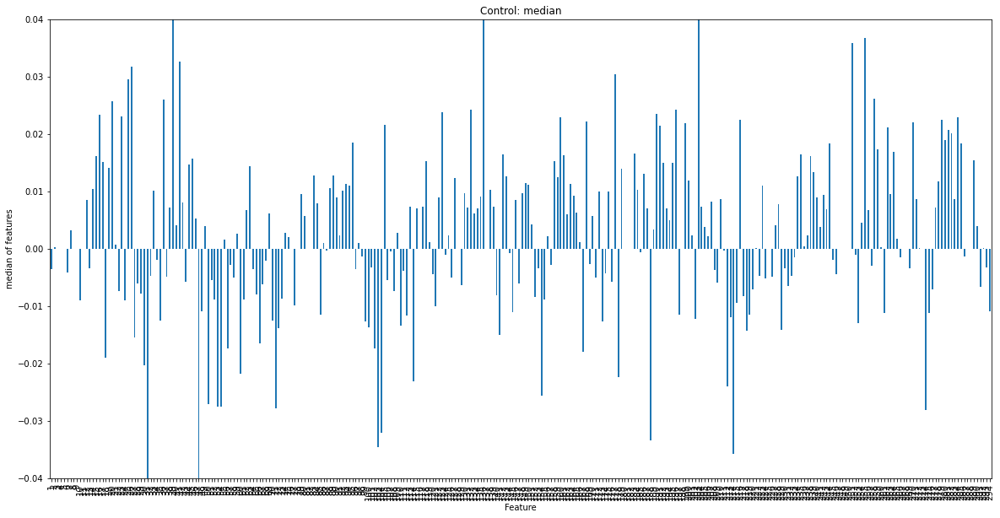

In [8]:
plt.figure()
brain_data.iloc[:,1:].mean().plot(kind='bar', figsize=(20,10), ylabel='mean of features', xlabel='Feature', ylim=(-0.04,0.04), title='All: mean')
plt.figure()
brain_data_alz.iloc[:,1:].mean().plot(kind='bar', figsize=(20,10), ylabel='mean of features', xlabel='Feature', ylim=(-0.04,0.04), title='alz: mean')
plt.figure()
brain_data_control.iloc[:,1:].mean().plot(kind='bar', figsize=(20,10), ylabel='mean of features', xlabel='Feature', ylim=(-0.04,0.04), title='Control: mean')
plt.figure()
brain_data.iloc[:,1:].median().plot(kind='bar', figsize=(20,10), ylabel='median of features', xlabel='Feature', ylim=(-0.04,0.04), title='All: median')
plt.figure()
brain_data_alz.iloc[:,1:].median().plot(kind='bar', figsize=(20,10), ylabel='median of features', xlabel='Feature', ylim=(-0.04,0.04), title='alz: median')
plt.figure()
brain_data_control.iloc[:,1:].median().plot(kind='bar', figsize=(20,10), ylabel='median of features', xlabel='Feature', ylim=(-0.04,0.04), title='Control: median')


# Putting it all together with mean and median

# View into individual patients

<AxesSubplot:>

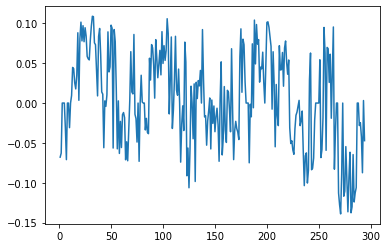

In [9]:
# plotting features of a single patient
one_patient = brain_data.iloc[0, 1:]
one_patient.plot()

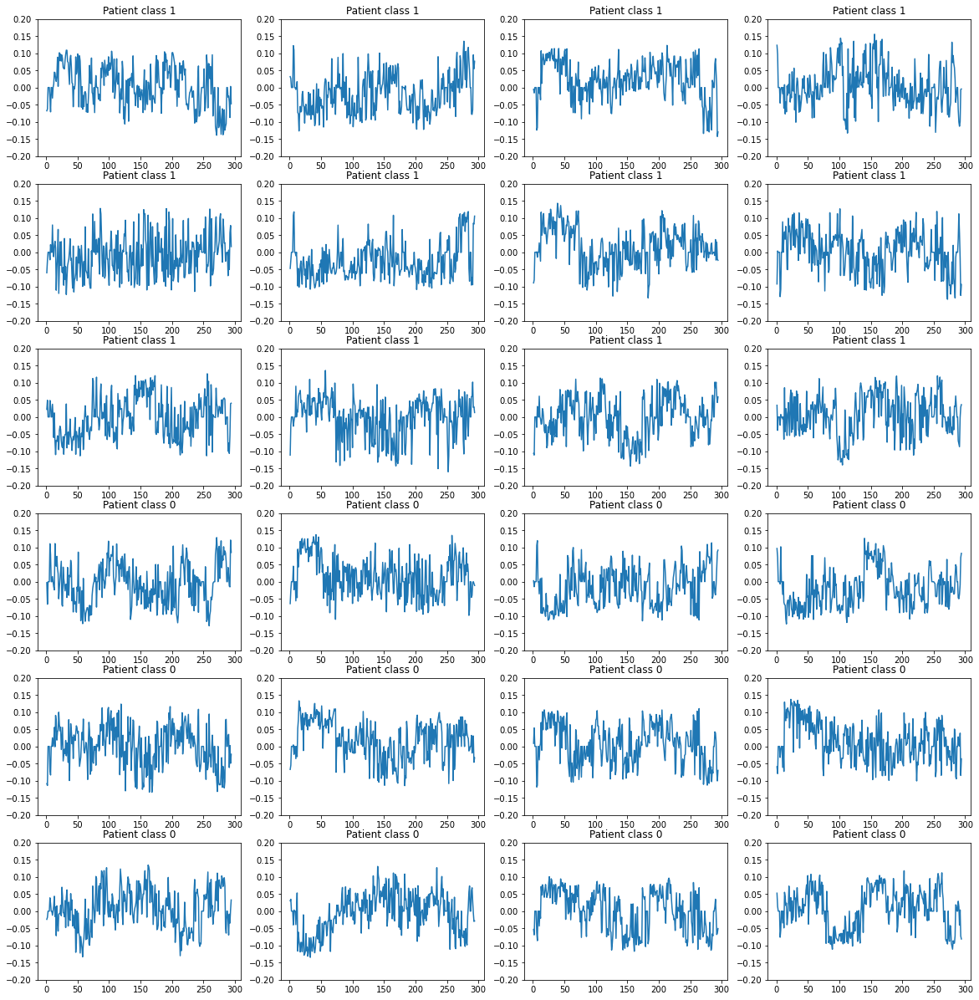

In [10]:
# Plot for several patients
num_patients = 25
num_cols = 4

## Create a position index
Rows = num_patients // num_cols
Rows += num_patients % num_cols
Position = range(1, num_patients + 1)

## Create Figure
fig = plt.figure(1, figsize=(20,90))
for x in range(num_patients//2):
    ax = fig.add_subplot(num_patients, num_cols, Position[x])
    brain_data.iloc[x, 1:].plot(title=f'Patient class {brain_data.iloc[x, 0]}', ylim=(-.2,.2))

for x in range(num_patients//2):
    ax = fig.add_subplot(num_patients, num_cols, Position[num_patients//2+x])
    brain_data.iloc[len(brain_data)-1-x, 1:].plot(title=f'Patient class {brain_data.iloc[len(brain_data)-1-x, 0]}', ylim=(-.2,.2))

# Distribution of features

array([[<AxesSubplot:title={'center':'1'}>,
        <AxesSubplot:title={'center':'2'}>,
        <AxesSubplot:title={'center':'3'}>,
        <AxesSubplot:title={'center':'4'}>,
        <AxesSubplot:title={'center':'5'}>,
        <AxesSubplot:title={'center':'6'}>,
        <AxesSubplot:title={'center':'7'}>,
        <AxesSubplot:title={'center':'8'}>,
        <AxesSubplot:title={'center':'9'}>],
       [<AxesSubplot:title={'center':'10'}>,
        <AxesSubplot:title={'center':'11'}>,
        <AxesSubplot:title={'center':'12'}>,
        <AxesSubplot:title={'center':'13'}>,
        <AxesSubplot:title={'center':'14'}>,
        <AxesSubplot:title={'center':'15'}>,
        <AxesSubplot:title={'center':'16'}>,
        <AxesSubplot:title={'center':'17'}>,
        <AxesSubplot:title={'center':'18'}>],
       [<AxesSubplot:title={'center':'19'}>,
        <AxesSubplot:title={'center':'20'}>,
        <AxesSubplot:title={'center':'21'}>,
        <AxesSubplot:title={'center':'22'}>,
        <AxesSubp

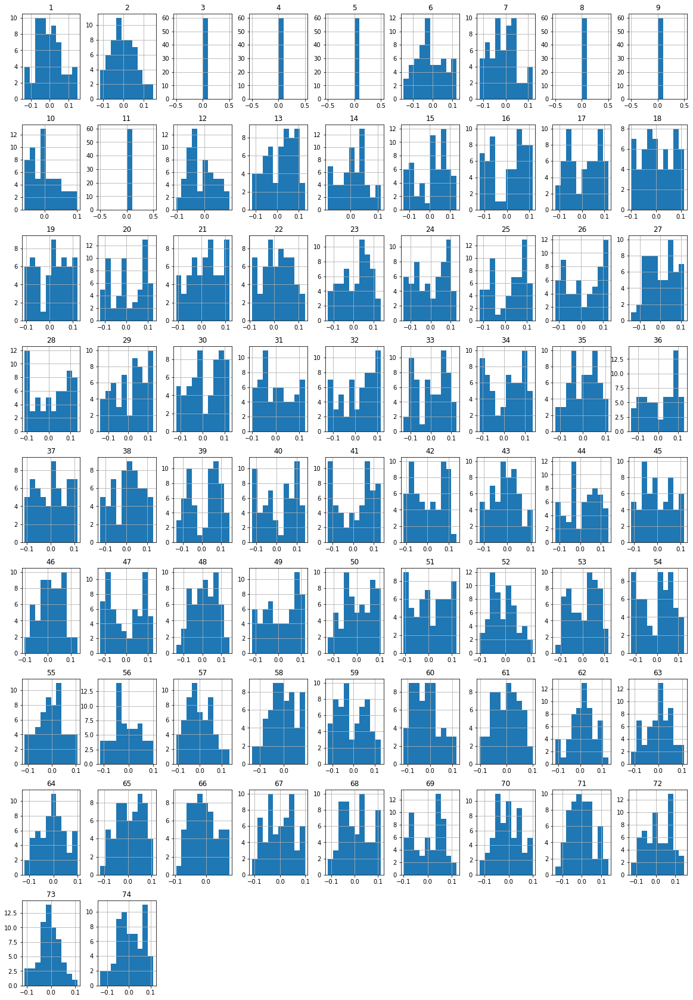

In [11]:
brain_data.iloc[:,1:75].hist(figsize=(20,30))

array([[<AxesSubplot:title={'center':'75'}>,
        <AxesSubplot:title={'center':'76'}>,
        <AxesSubplot:title={'center':'77'}>,
        <AxesSubplot:title={'center':'78'}>,
        <AxesSubplot:title={'center':'79'}>,
        <AxesSubplot:title={'center':'80'}>,
        <AxesSubplot:title={'center':'81'}>,
        <AxesSubplot:title={'center':'82'}>,
        <AxesSubplot:title={'center':'83'}>],
       [<AxesSubplot:title={'center':'84'}>,
        <AxesSubplot:title={'center':'85'}>,
        <AxesSubplot:title={'center':'86'}>,
        <AxesSubplot:title={'center':'87'}>,
        <AxesSubplot:title={'center':'88'}>,
        <AxesSubplot:title={'center':'89'}>,
        <AxesSubplot:title={'center':'90'}>,
        <AxesSubplot:title={'center':'91'}>,
        <AxesSubplot:title={'center':'92'}>],
       [<AxesSubplot:title={'center':'93'}>,
        <AxesSubplot:title={'center':'94'}>,
        <AxesSubplot:title={'center':'95'}>,
        <AxesSubplot:title={'center':'96'}>,
        

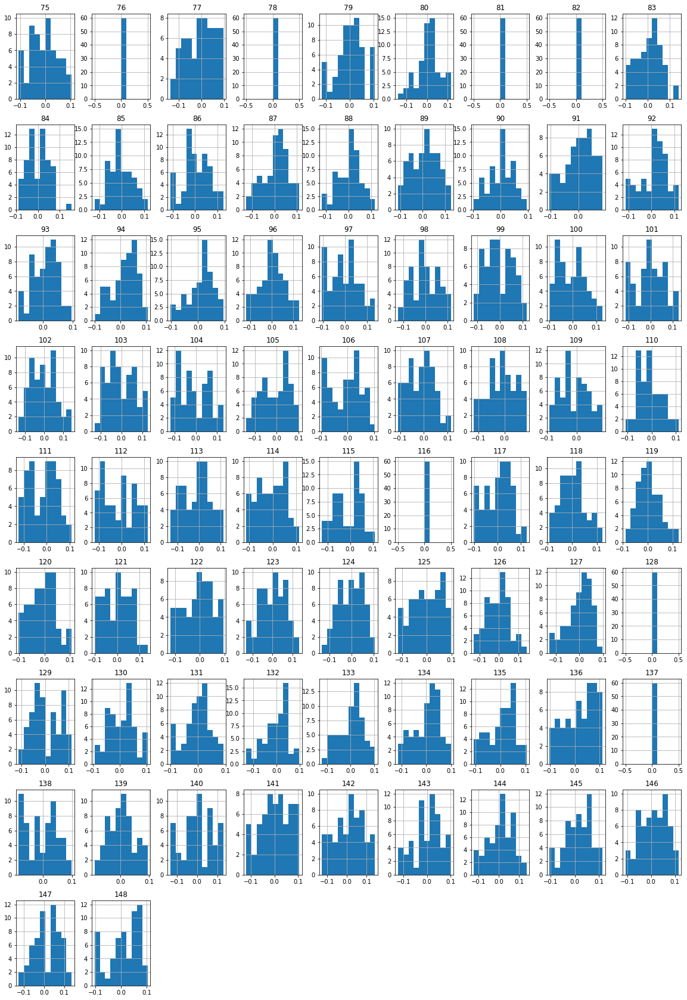

In [12]:
brain_data.iloc[:,75:149].hist(figsize=(20,30))

# Correlations

<AxesSubplot:>

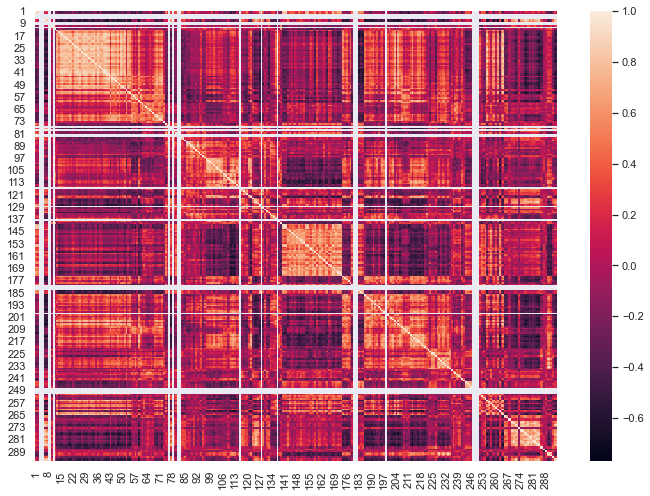

In [30]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.heatmap(brain_data.iloc[:,1:].corr())